In [5]:
!python3 -m pip install -r req.txt

  Using cached ultralytics-8.3.241-py3-none-any.whl.metadata (37 kB)
  Using cached setuptools-80.9.0-py3-none-any.whl.metadata (6.6 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.9/37.9 MB 2.4 MB/s  0:00:15m0:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 4.0 MB/s  0:00:01 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 2.7 MB/s  0:00:00 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.1/8.1 MB 3.1 MB/s  0:00:02m0:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 3.4 MB/s  0:00:00 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 802.4/802.4 kB 4.5 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.3/39.3 MB 3.6 MB/s  0:00:10m0:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.9/20.9 MB 1.9 MB/s  0:00:11m0:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.5/74.5 MB 2.2 MB/s  0:00:34m0:00:0100:02
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 6.2 MB/s  0:00:00 eta 0:00:01
   ━━━━━

In [2]:
import os
import random
import pandas as pd
from PIL import Image
import cv2
from ultralytics import YOLO
from IPython.display import Video
import numpy as np  
import matplotlib.pyplot as plt
import seaborn as sns
import pathlib
import glob
from tqdm.notebook import trange, tqdm
import yaml
%matplotlib inline
import tkinter as tk
from tkinter import filedialog, messagebox
import cv2
from PIL import Image, ImageTk
from ultralytics import YOLO
import os
import time

In [3]:
root_dir = "Turkey Road Sign.v1i.yolov11"

for root, dirs, files in os.walk(root_dir):
    level = root.replace(root_dir, '').count(os.sep)
    indent = '  ' * level
    print(f"{indent}{os.path.basename(root)}/")


Turkey Road Sign.v1i.yolov11/
  train/
    images/
    labels/
  valid/
    images/
    labels/


In [4]:
yaml_path="Turkey Road Sign.v1i.yolov11/data.yaml"
with open(yaml_path,"r") as file:
    data=yaml.safe_load(file)
print(data)

{'train': '../train/images', 'val': '../valid/images', 'test': '../test/images', 'nc': 16, 'names': ['20', '30', 'dur', 'durak', 'girisyok', 'ilerisag', 'ilerisol', 'kirmizi', 'park', 'parkyasak', 'sag', 'sagadonulmez', 'sari', 'sol', 'soladonulmez', 'yesil'], 'roboflow': {'workspace': 'turkeyroadsigns', 'project': 'turkey-road-sign', 'version': 1, 'license': 'CC BY 4.0', 'url': 'https://universe.roboflow.com/turkeyroadsigns/turkey-road-sign/dataset/1'}}


In [5]:
for idx, name in enumerate(data['names']):
    print(f"{idx}: {name}")

0: 20
1: 30
2: dur
3: durak
4: girisyok
5: ilerisag
6: ilerisol
7: kirmizi
8: park
9: parkyasak
10: sag
11: sagadonulmez
12: sari
13: sol
14: soladonulmez
15: yesil


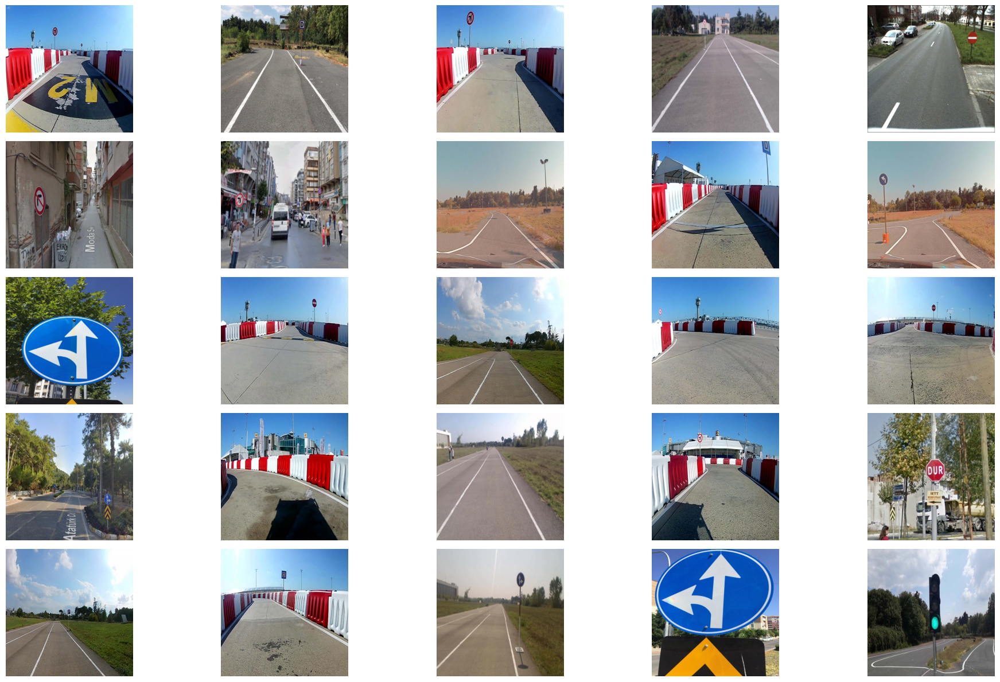

In [6]:
train_images_dir = "Turkey Road Sign.v1i.yolov11/train/images/"

# Get list of image files
image_files = [f for f in os.listdir(train_images_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Pick 25 random images (or less if not enough)
sample_files = random.sample(image_files, min(25, len(image_files)))

plt.figure(figsize=(20,12))

for i, img_name in enumerate(sample_files, 1):
    img_path = os.path.join(train_images_dir, img_name)
    img = Image.open(img_path)
    plt.subplot(5,5,i)
    plt.imshow(img)
    plt.axis('off')

plt.tight_layout()
plt.show()

In [7]:
image_files = [f for f in os.listdir(train_images_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

for img_name in image_files[:5]:  # Check first 5 images
    img_path = os.path.join(train_images_dir, img_name)
    image = cv2.imread(img_path)
    if image is not None:
        h, w, c = image.shape
        print(f"Image: {img_name} - Height: {h}, Width: {w}, Channels: {c}")
    else:
        print(f"Failed to load {img_name}")

Image: 20_100_jpg.rf.a152b0b7bde8551a544bf22b7add587e.jpg - Height: 640, Width: 640, Channels: 3
Image: 20_101_jpg.rf.57eea6a41cf18fd5e47581054172c8c5.jpg - Height: 640, Width: 640, Channels: 3
Image: 20_102_jpg.rf.495511ba14c7b00ca8fb9cb0dd9060da.jpg - Height: 640, Width: 640, Channels: 3
Image: 20_103_jpg.rf.7d1a56ec66e4450b42dc8870a7576006.jpg - Height: 640, Width: 640, Channels: 3
Image: 20_104_jpg.rf.f820e94cd3fd6ecdcd289a3d35b6ea96.jpg - Height: 640, Width: 640, Channels: 3


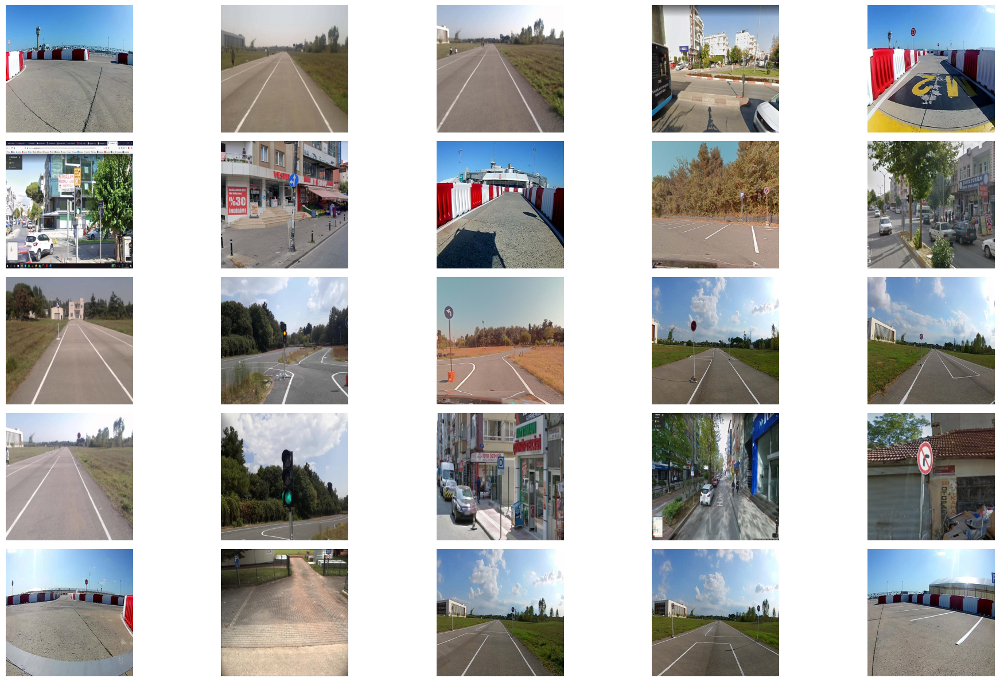

In [8]:
valid_images_dir = "Turkey Road Sign.v1i.yolov11/valid/images/"

# Get list of image files
image_files = [f for f in os.listdir(valid_images_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Pick 25 random images (or less if not enough)
sample_files = random.sample(image_files, min(25, len(image_files)))

plt.figure(figsize=(20,12))

for i, img_name in enumerate(sample_files, 1):
    img_path = os.path.join(valid_images_dir, img_name)
    img = Image.open(img_path)
    plt.subplot(5,5,i)
    plt.imshow(img)
    plt.axis('off')

plt.tight_layout()
plt.show()

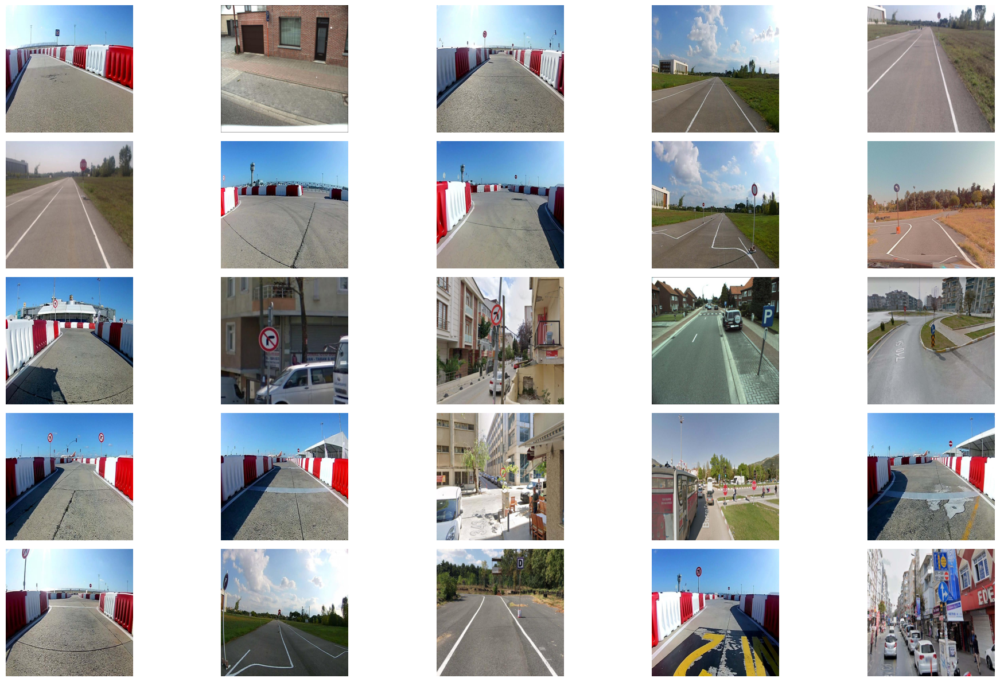

In [10]:
test_images_dir = "Turkey Road Sign.v1i.yolov11/valid/images/"

# List image files
image_files = [f for f in os.listdir(test_images_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Sample 25 images or less if not enough
sample_files = random.sample(image_files, min(25, len(image_files)))

plt.figure(figsize=(20,12))

for i, img_name in enumerate(sample_files, 1):
    img_path = os.path.join(test_images_dir, img_name)
    img = Image.open(img_path)
    plt.subplot(5,5,i)
    plt.imshow(img)
    plt.axis('off')

plt.tight_layout()
plt.show()


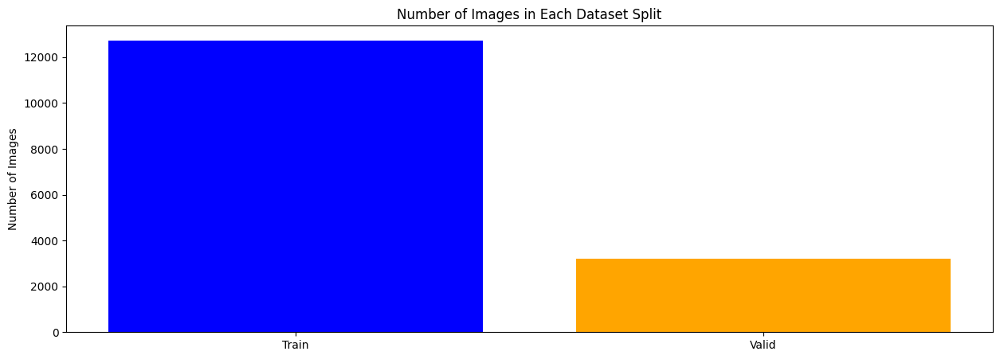

In [11]:
train_dir = "Turkey Road Sign.v1i.yolov11/train/images/"
valid_dir = "Turkey Road Sign.v1i.yolov11/valid/images/"
# test_dir = "Turkey Road Sign.v1i.yolov11/car/test/images/"

# Count images in each folder
train_count = len([f for f in os.listdir(train_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
valid_count = len([f for f in os.listdir(valid_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
# test_count = len([f for f in os.listdir(test_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])

# Plotting
plt.figure(figsize=(15,5))
plt.bar(['Train', 'Valid'], [train_count, valid_count], color=['blue', 'orange'])
plt.title('Number of Images in Each Dataset Split')
plt.ylabel('Number of Images')
plt.show()

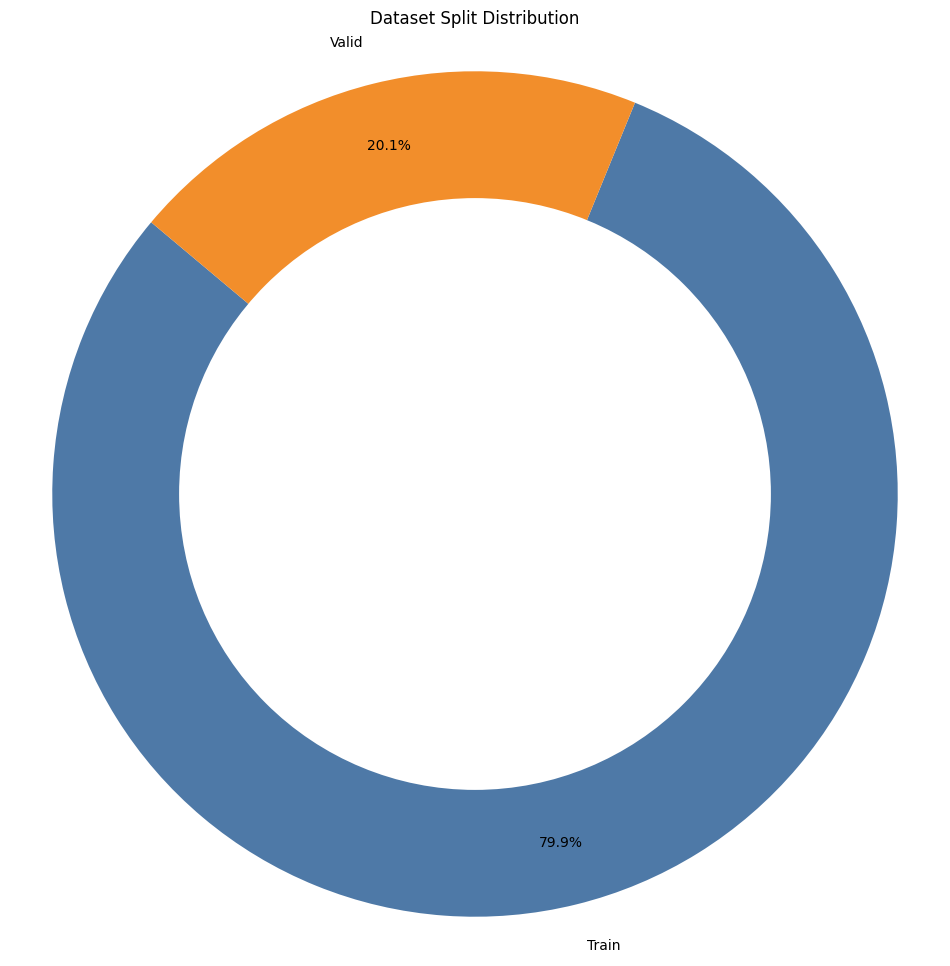

In [12]:
labels = ['Train', 'Valid']
counts = [train_count, valid_count]
colors = ['#4e79a7', '#f28e2b']

# Plot donut chart
plt.figure(figsize=(12,12))
wedges, texts, autotexts = plt.pie(counts, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140, pctdistance=0.85)

# Draw circle for donut shape
centre_circle = plt.Circle((0,0),0.70,fc='white')
plt.gca().add_artist(centre_circle)

plt.title('Dataset Split Distribution')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
plt.show()

In [ ]:
model=YOLO("yolo11n.pt")

history=model.train(data=yaml_path,epochs=25,batch=-1,optimizer="auto")

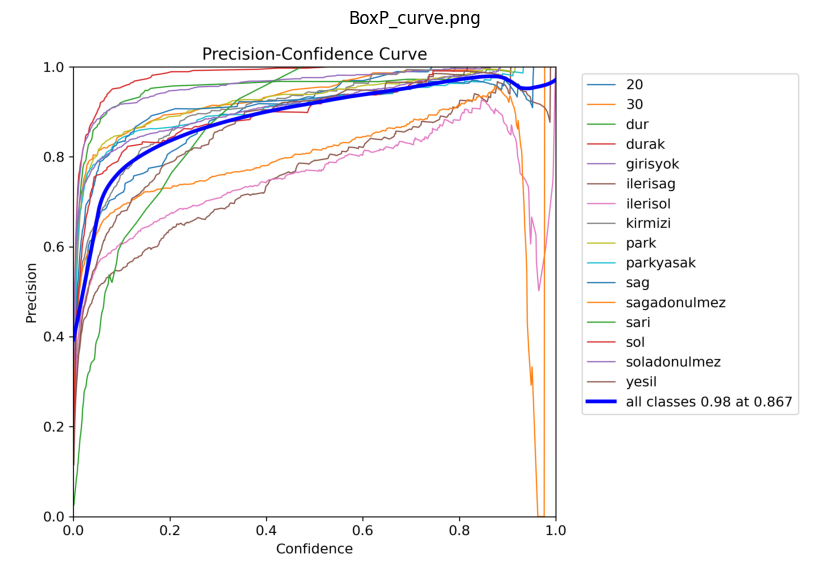

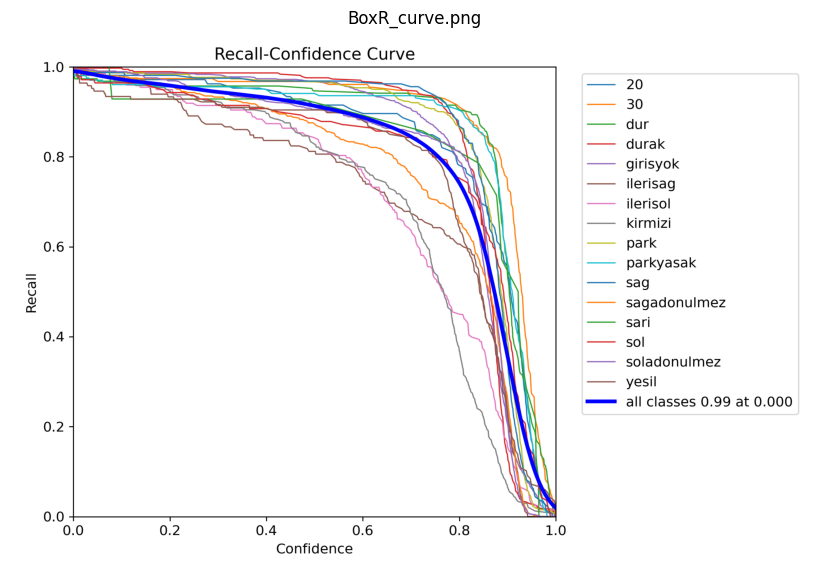

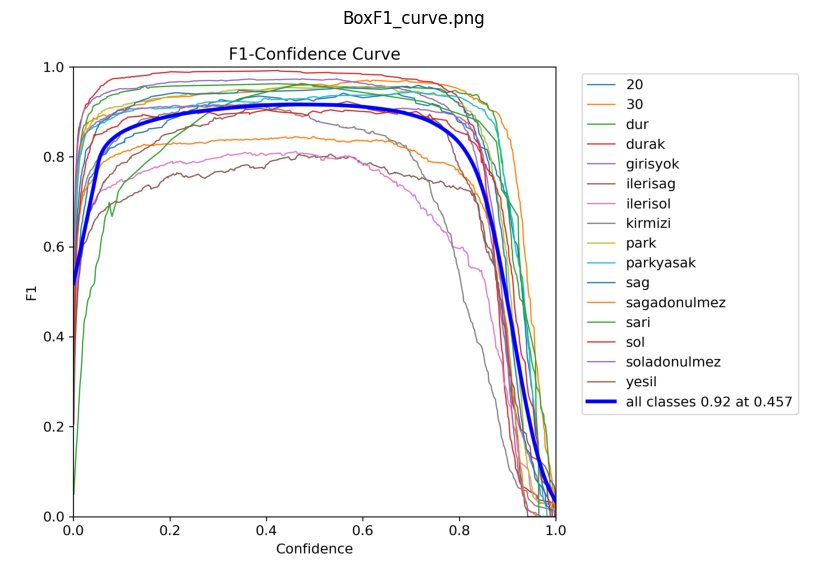

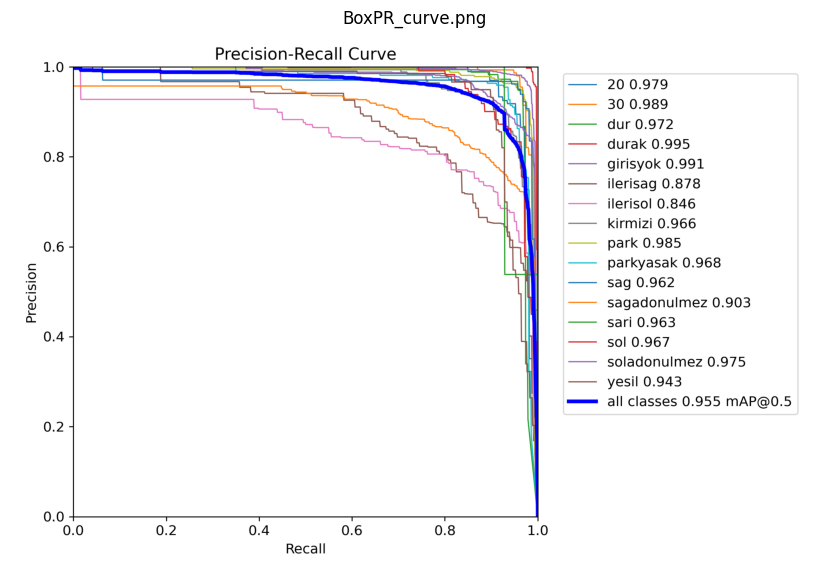

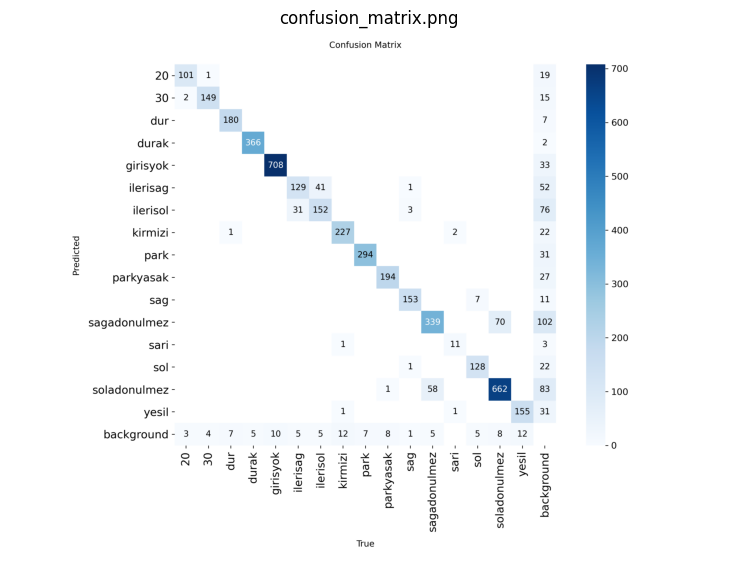

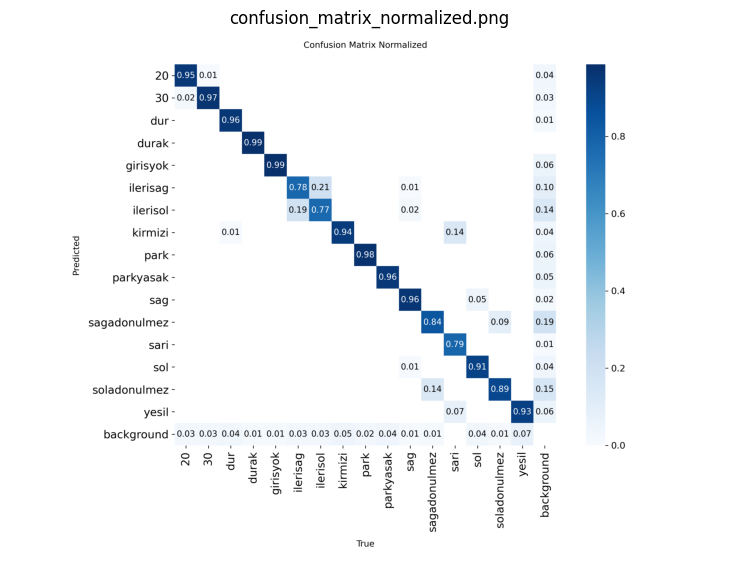

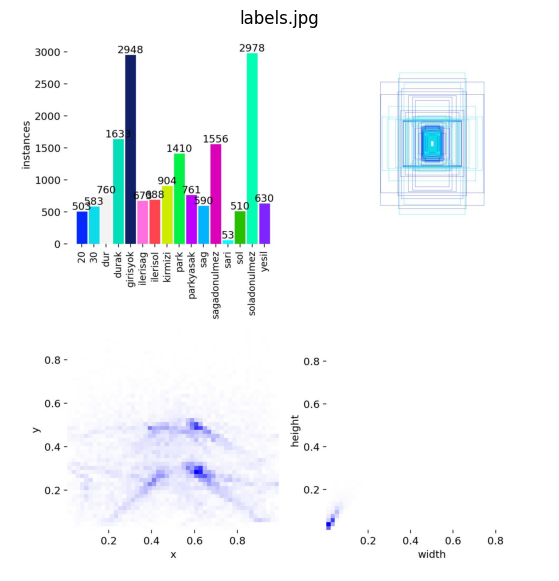

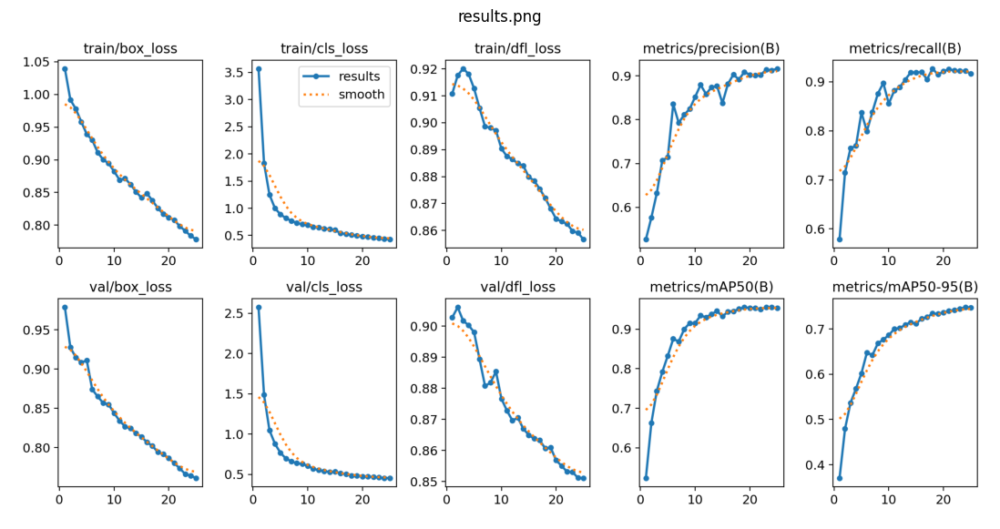

In [10]:
output_dir = "runs/detect/train2"
plot_files = [
    "BoxP_curve.png", "BoxR_curve.png", "BoxF1_curve.png", "BoxPR_curve.png",
    "confusion_matrix.png", "confusion_matrix_normalized.png",
    "labels.jpg", "labels_correlogram.jpg", "results.png"
]

# Filter only existing files
existing_plots = [f for f in plot_files if os.path.exists(os.path.join(output_dir, f))]

# Show each image individually
for file in existing_plots:
    img_path = os.path.join(output_dir, file)
    img = Image.open(img_path)
    plt.figure(figsize=(15, 7))
    plt.imshow(img)
    plt.title(file)
    plt.axis('off')
    plt.show()

In [8]:
model_result=pd.read_csv("runs/detect/train2/results.csv")

In [11]:
model_result.head()

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,3197.33,1.03959,3.57058,0.91078,0.52672,0.57854,0.52369,0.37054,0.97877,2.57482,0.90275,0.000166,0.000166,0.000166
1,2,6191.32,0.99198,1.82723,0.91757,0.57654,0.71505,0.66297,0.47921,0.92759,1.48643,0.90605,0.000320,0.000320,0.000320
2,3,9115.34,0.97789,1.24925,0.92010,0.63225,0.76436,0.74399,0.53642,0.91484,1.04645,0.90170,0.000460,0.000460,0.000460
3,4,12040.10,0.95814,0.99843,0.91811,0.70713,0.76936,0.79192,0.56809,0.90828,0.87835,0.90025,0.000441,0.000441,0.000441
4,5,14967.30,0.93923,0.88965,0.91268,0.71412,0.83724,0.83265,0.60179,0.91110,0.76809,0.89801,0.000421,0.000421,0.000421


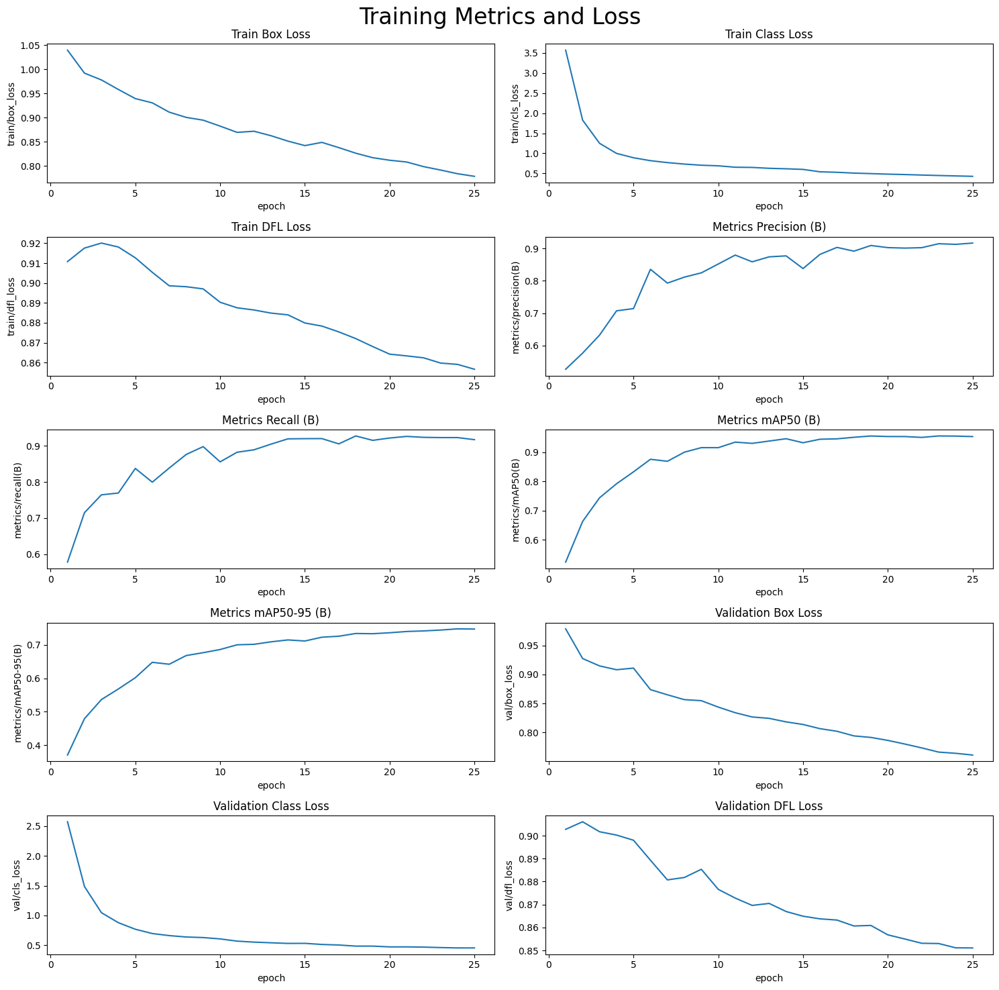

In [12]:
model_result.columns = model_result.columns.str.strip()

fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 15))

# Plot the columns using seaborn
sns.lineplot(x='epoch', y='train/box_loss', data=model_result, ax=axs[0,0])
sns.lineplot(x='epoch', y='train/cls_loss', data=model_result, ax=axs[0,1])
sns.lineplot(x='epoch', y='train/dfl_loss', data=model_result, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/precision(B)', data=model_result, ax=axs[1,1])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=model_result, ax=axs[2,0])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=model_result, ax=axs[2,1])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=model_result, ax=axs[3,0])
sns.lineplot(x='epoch', y='val/box_loss', data=model_result, ax=axs[3,1])
sns.lineplot(x='epoch', y='val/cls_loss', data=model_result, ax=axs[4,0])
sns.lineplot(x='epoch', y='val/dfl_loss', data=model_result, ax=axs[4,1])

# Set titles and axis labels for each subplot
axs[0,0].set(title='Train Box Loss')
axs[0,1].set(title='Train Class Loss')
axs[1,0].set(title='Train DFL Loss')
axs[1,1].set(title='Metrics Precision (B)')
axs[2,0].set(title='Metrics Recall (B)')
axs[2,1].set(title='Metrics mAP50 (B)')
axs[3,0].set(title='Metrics mAP50-95 (B)')
axs[3,1].set(title='Validation Box Loss')
axs[4,0].set(title='Validation Class Loss')
axs[4,1].set(title='Validation DFL Loss')


plt.suptitle('Training Metrics and Loss', fontsize=24)
plt.subplots_adjust(top=0.8)
plt.tight_layout()
plt.show()

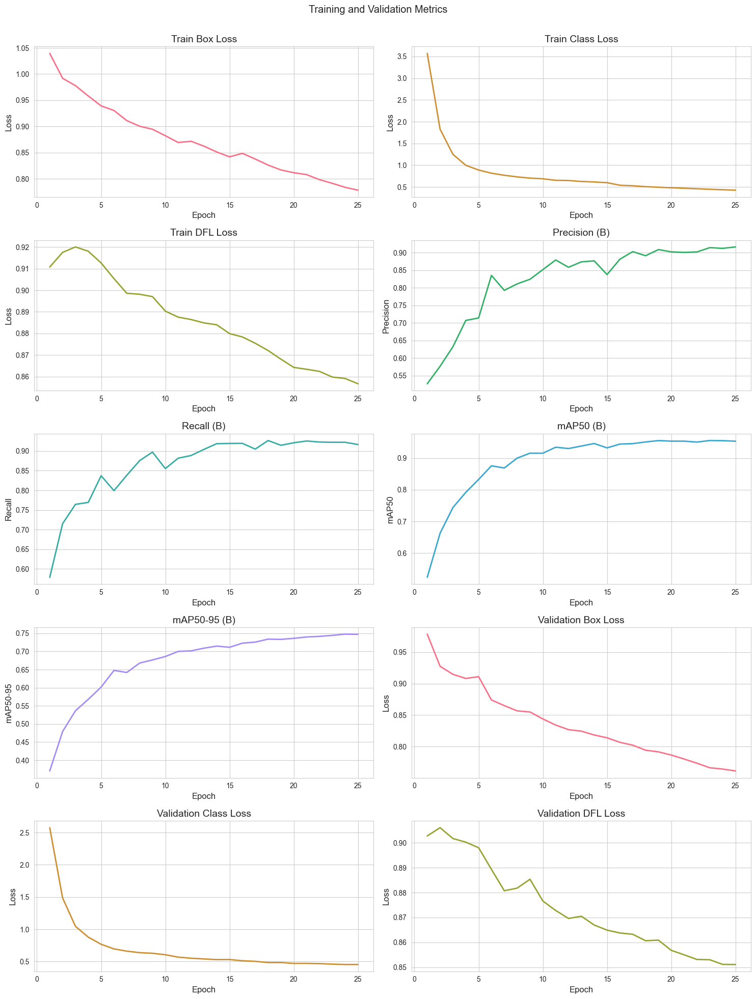

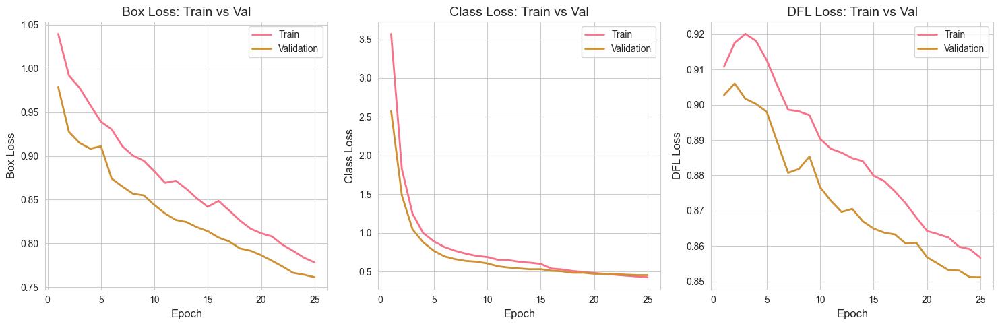

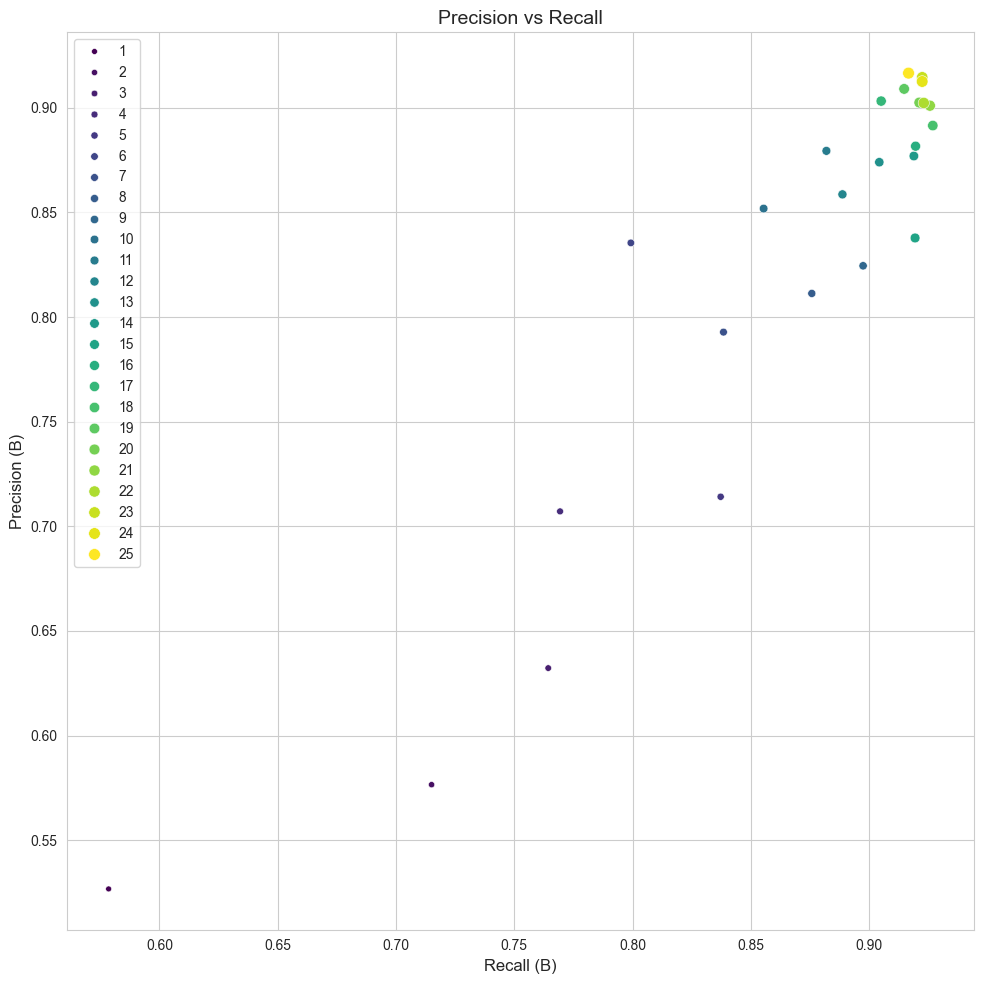

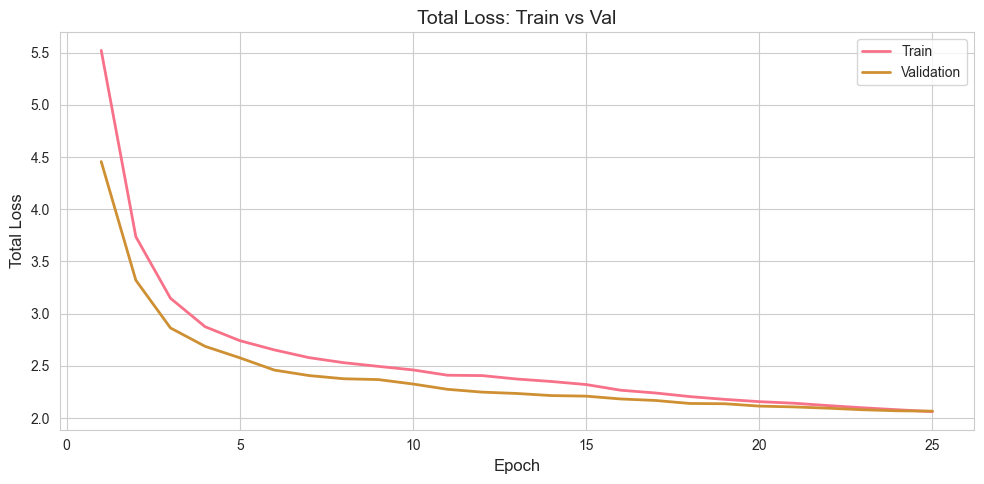

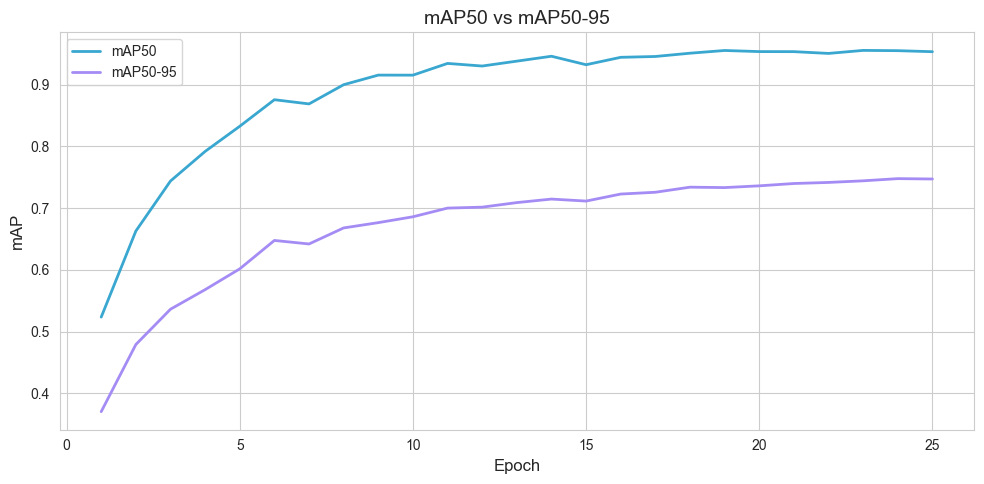

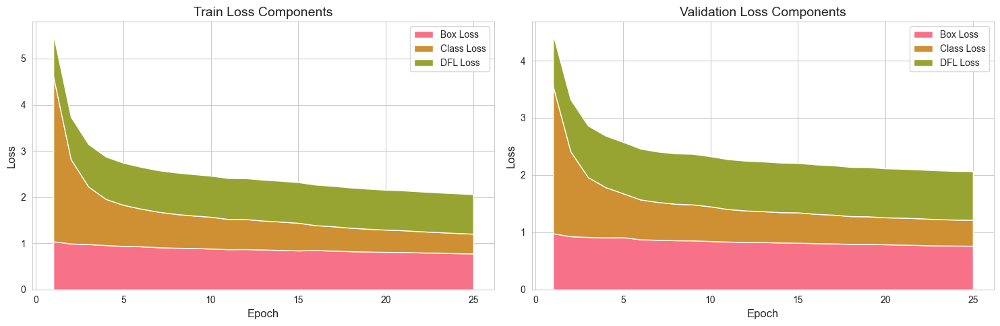

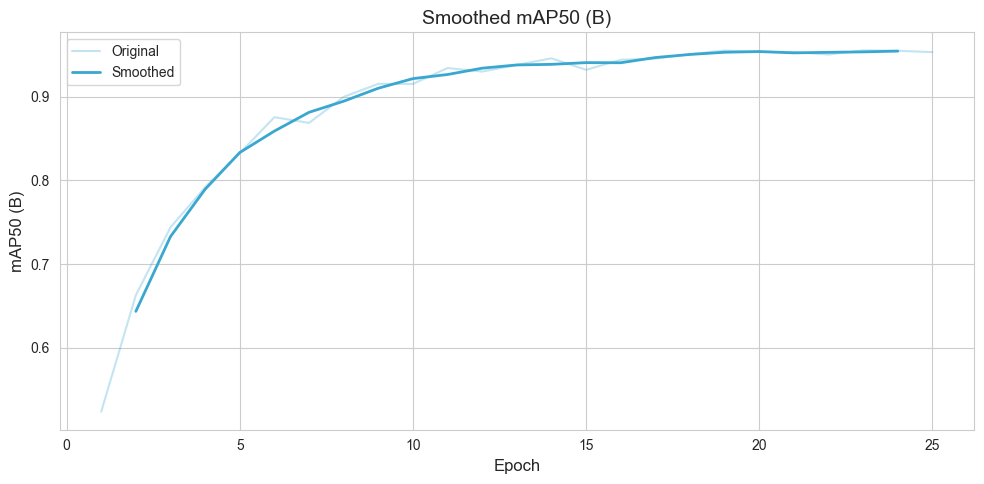

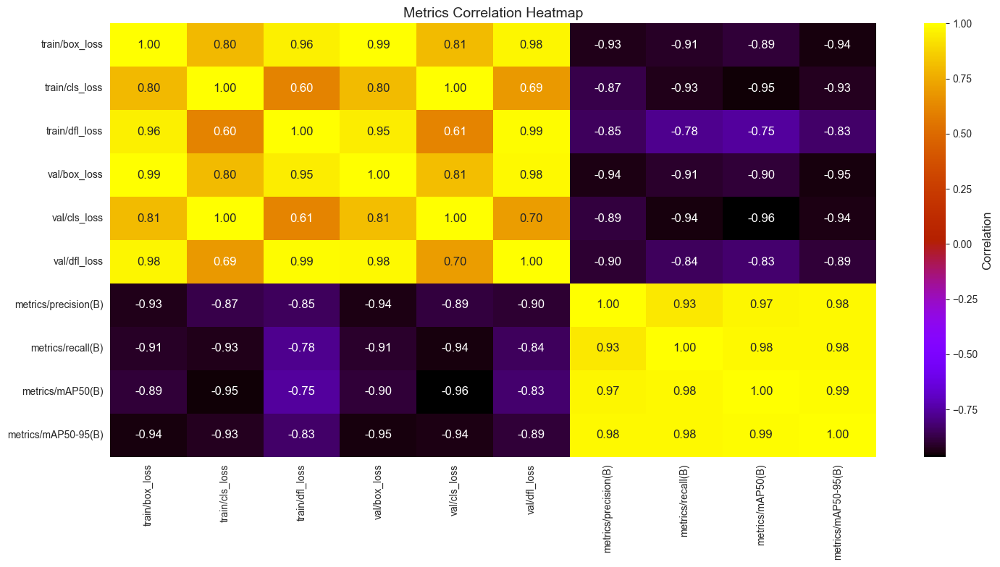

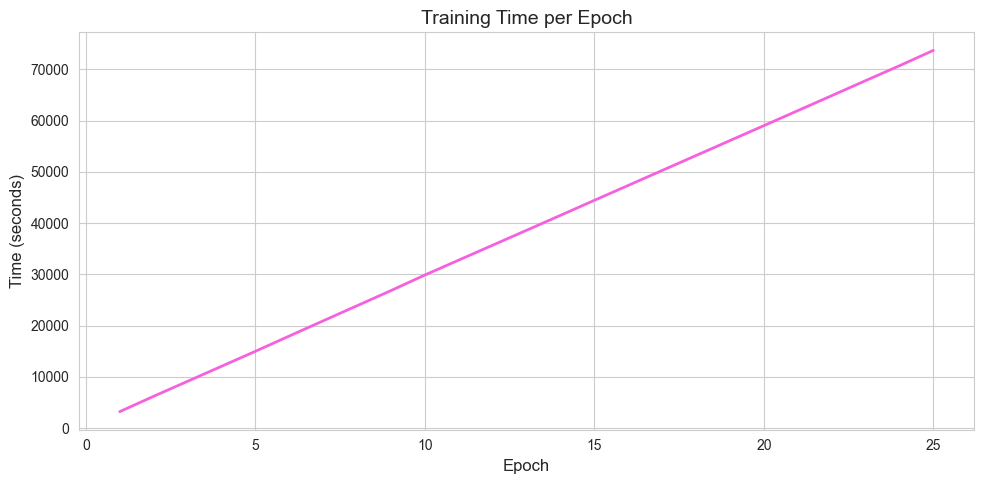

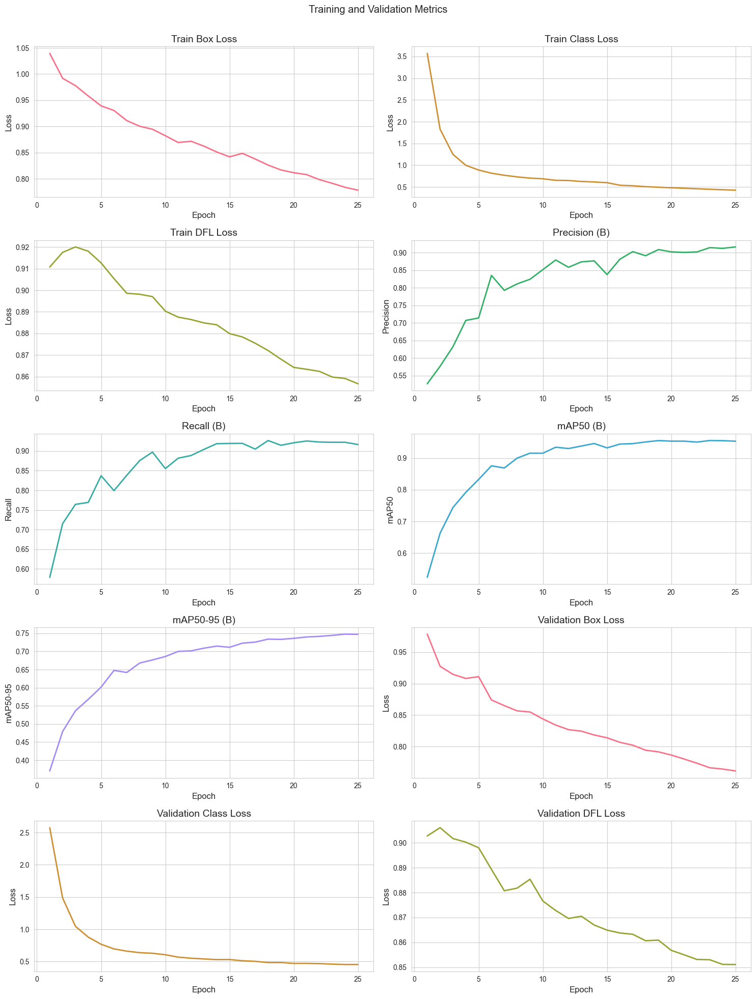

In [18]:
# Set Seaborn style for better aesthetics
sns.set_style("whitegrid")
plt.rcParams['font.size'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

# Define a color palette for consistency
colors = sns.color_palette("husl", 8)

# Strip whitespace from column names (just in case)
model_result.columns = model_result.columns.str.strip()

# Create figure with subplots for original plots (5 rows, 2 columns)
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 20), dpi=100)

# Original plots
sns.lineplot(x='epoch', y='train/box_loss', data=model_result, ax=axs[0, 0], color=colors[0], linewidth=2)
sns.lineplot(x='epoch', y='train/cls_loss', data=model_result, ax=axs[0, 1], color=colors[1], linewidth=2)
sns.lineplot(x='epoch', y='train/dfl_loss', data=model_result, ax=axs[1, 0], color=colors[2], linewidth=2)
sns.lineplot(x='epoch', y='metrics/precision(B)', data=model_result, ax=axs[1, 1], color=colors[3], linewidth=2)
sns.lineplot(x='epoch', y='metrics/recall(B)', data=model_result, ax=axs[2, 0], color=colors[4], linewidth=2)
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=model_result, ax=axs[2, 1], color=colors[5], linewidth=2)
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=model_result, ax=axs[3, 0], color=colors[6], linewidth=2)
sns.lineplot(x='epoch', y='val/box_loss', data=model_result, ax=axs[3, 1], color=colors[0], linewidth=2)
sns.lineplot(x='epoch', y='val/cls_loss', data=model_result, ax=axs[4, 0], color=colors[1], linewidth=2)
sns.lineplot(x='epoch', y='val/dfl_loss', data=model_result, ax=axs[4, 1], color=colors[2], linewidth=2)

# Set titles and labels
axs[0, 0].set(title='Train Box Loss', xlabel='Epoch', ylabel='Loss')
axs[0, 1].set(title='Train Class Loss', xlabel='Epoch', ylabel='Loss')
axs[1, 0].set(title='Train DFL Loss', xlabel='Epoch', ylabel='Loss')
axs[1, 1].set(title='Precision (B)', xlabel='Epoch', ylabel='Precision')
axs[2, 0].set(title='Recall (B)', xlabel='Epoch', ylabel='Recall')
axs[2, 1].set(title='mAP50 (B)', xlabel='Epoch', ylabel='mAP50')
axs[3, 0].set(title='mAP50-95 (B)', xlabel='Epoch', ylabel='mAP50-95')
axs[3, 1].set(title='Validation Box Loss', xlabel='Epoch', ylabel='Loss')
axs[4, 0].set(title='Validation Class Loss', xlabel='Epoch', ylabel='Loss')
axs[4, 1].set(title='Validation DFL Loss', xlabel='Epoch', ylabel='Loss')

# Main title and layout
plt.suptitle('Training and Validation Metrics\n\n')
plt.tight_layout()

# Additional Plots
# 1. Train vs Validation Loss Comparison
fig_comp, axs_comp = plt.subplots(1, 3, figsize=(15, 5), dpi=100)
sns.lineplot(x='epoch', y='train/box_loss', data=model_result, label='Train', ax=axs_comp[0], color=colors[0], linewidth=2)
sns.lineplot(x='epoch', y='val/box_loss', data=model_result, label='Validation', ax=axs_comp[0], color=colors[1], linewidth=2)
axs_comp[0].set(title='Box Loss: Train vs Val', xlabel='Epoch', ylabel='Box Loss')
axs_comp[0].legend()

sns.lineplot(x='epoch', y='train/cls_loss', data=model_result, label='Train', ax=axs_comp[1], color=colors[0], linewidth=2)
sns.lineplot(x='epoch', y='val/cls_loss', data=model_result, label='Validation', ax=axs_comp[1], color=colors[1], linewidth=2)
axs_comp[1].set(title='Class Loss: Train vs Val', xlabel='Epoch', ylabel='Class Loss')
axs_comp[1].legend()

sns.lineplot(x='epoch', y='train/dfl_loss', data=model_result, label='Train', ax=axs_comp[2], color=colors[0], linewidth=2)
sns.lineplot(x='epoch', y='val/dfl_loss', data=model_result, label='Validation', ax=axs_comp[2], color=colors[1], linewidth=2)
axs_comp[2].set(title='DFL Loss: Train vs Val', xlabel='Epoch', ylabel='DFL Loss')
axs_comp[2].legend()

plt.tight_layout()
plt.show()

# 2. Precision vs Recall Scatter Plot
fig_pr, ax_pr = plt.subplots(figsize=(10, 10), dpi=100)
sns.scatterplot(x='metrics/recall(B)', y='metrics/precision(B)', hue='epoch', size='epoch',palette='viridis', data=model_result, ax=ax_pr, legend='full')
ax_pr.set(title='Precision vs Recall', xlabel='Recall (B)', ylabel='Precision (B)')
plt.legend(loc="best")
plt.tight_layout()
plt.show()

# 3. Total Loss
model_result['train/total_loss'] = model_result['train/box_loss'] + model_result['train/cls_loss'] + model_result['train/dfl_loss']
model_result['val/total_loss'] = model_result['val/box_loss'] + model_result['val/cls_loss'] + model_result['val/dfl_loss']

fig_total, ax_total = plt.subplots(figsize=(10, 5), dpi=100)
sns.lineplot(x='epoch', y='train/total_loss', data=model_result, label='Train', ax=ax_total, color=colors[0], linewidth=2)
sns.lineplot(x='epoch', y='val/total_loss', data=model_result, label='Validation', ax=ax_total, color=colors[1], linewidth=2)
ax_total.set(title='Total Loss: Train vs Val', xlabel='Epoch', ylabel='Total Loss')
ax_total.legend()
plt.tight_layout()
plt.show()

# 4. mAP50 vs mAP50-95
fig_map, ax_map = plt.subplots(figsize=(10, 5), dpi=100)
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=model_result, label='mAP50', ax=ax_map, color=colors[5], linewidth=2)
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=model_result, label='mAP50-95', ax=ax_map, color=colors[6], linewidth=2)
ax_map.set(title='mAP50 vs mAP50-95', xlabel='Epoch', ylabel='mAP')
ax_map.legend()
plt.tight_layout()
plt.show()

# 5. Loss Components Contribution (Stacked Area Plot)
fig_stack, axs_stack = plt.subplots(1, 2, figsize=(15, 5), dpi=100)
axs_stack[0].stackplot(model_result['epoch'],
                       model_result['train/box_loss'],
                       model_result['train/cls_loss'],
                       model_result['train/dfl_loss'],
                       labels=['Box Loss', 'Class Loss', 'DFL Loss'],
                       colors=colors[:3])
axs_stack[0].set(title='Train Loss Components', xlabel='Epoch', ylabel='Loss')
axs_stack[0].legend(loc='upper right')

axs_stack[1].stackplot(model_result['epoch'],
                       model_result['val/box_loss'],
                       model_result['val/cls_loss'],
                       model_result['val/dfl_loss'],
                       labels=['Box Loss', 'Class Loss', 'DFL Loss'],
                       colors=colors[:3])
axs_stack[1].set(title='Validation Loss Components', xlabel='Epoch', ylabel='Loss')
axs_stack[1].legend(loc='upper right')
plt.tight_layout()
plt.show()

# 6. Smoothed Metrics (e.g., mAP50)
model_result_smoothed = model_result.rolling(window=3, center=True).mean()
fig_smooth, ax_smooth = plt.subplots(figsize=(10, 5), dpi=100)
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=model_result, label='Original', alpha=0.3, ax=ax_smooth, color=colors[5])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=model_result_smoothed, label='Smoothed', ax=ax_smooth, color=colors[5], linewidth=2)
ax_smooth.set(title='Smoothed mAP50 (B)', xlabel='Epoch', ylabel='mAP50 (B)')
ax_smooth.legend()
plt.tight_layout()
plt.show()

# 7. Metrics Correlation Heatmap
metrics_cols = ['train/box_loss', 'train/cls_loss', 'train/dfl_loss', 
                'val/box_loss', 'val/cls_loss', 'val/dfl_loss', 
                'metrics/precision(B)', 'metrics/recall(B)', 
                'metrics/mAP50(B)', 'metrics/mAP50-95(B)']
correlation_matrix = model_result[metrics_cols].corr()

fig_corr, ax_corr = plt.subplots(figsize=(15, 8), dpi=100)
sns.heatmap(correlation_matrix, annot=True, cmap='gnuplot', fmt='.2f', ax=ax_corr, cbar_kws={'label': 'Correlation'})
ax_corr.set(title='Metrics Correlation Heatmap')
plt.tight_layout()
plt.show()

# 8. Training Time Plot (using 'time' column)
fig_time, ax_time = plt.subplots(figsize=(10, 5), dpi=100)
sns.lineplot(x='epoch', y='time', data=model_result, ax=ax_time, color=colors[7], linewidth=2)
ax_time.set(title='Training Time per Epoch', xlabel='Epoch', ylabel='Time (seconds)')
plt.tight_layout()
plt.show()

# Display the original plot
plt.figure(fig)
plt.show()

# Print all metrics

In [ ]:
best_model="runs/detect/train2/weights/best.pt"
test_model=YOLO(best_model)
metrics=test_model.val()


for metric_name, value in metrics.results_dict.items():
    print(f"{metric_name}: {value}")


In [13]:

def resize_image(image, size=(640, 640)):
    return cv2.resize(image, size)


0: 640x640 1 kirmizi, 2 sagadonulmezs, 1 soladonulmez, 3 yesils, 56.1ms
Speed: 2.5ms preprocess, 56.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


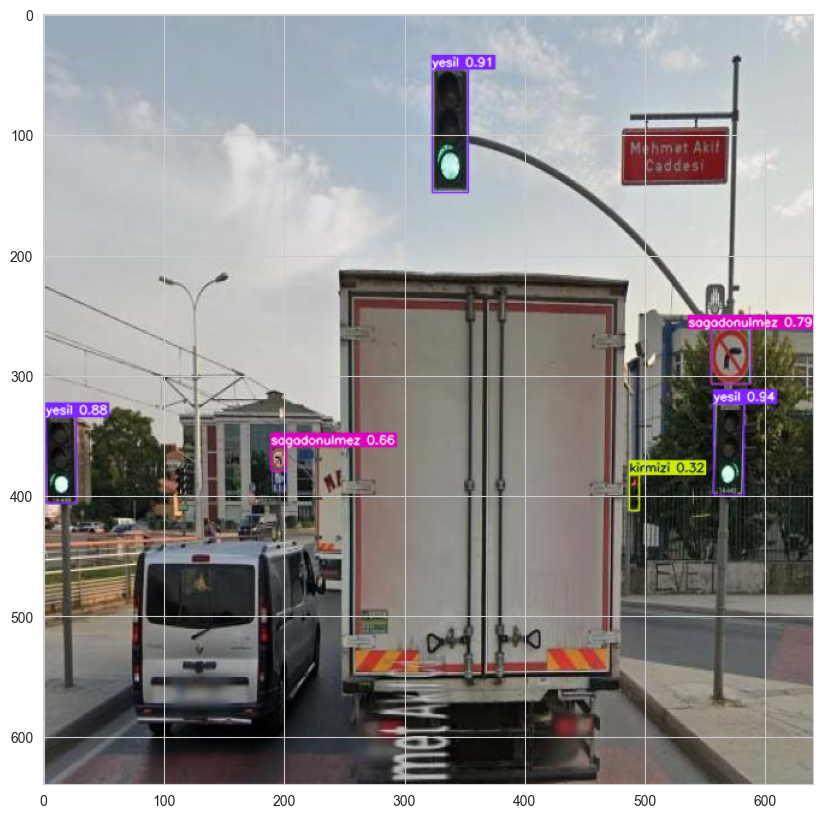

In [22]:
test_image_path='Turkey Road Sign.v1i.yolov11\\valid\\images\\sold_sagd_krmz_ysl_1_jpg.rf.052c719fcdaff72f500d9bde73142d61.jpg'
test_image = cv2.imread(test_image_path)
resized_image = resize_image(test_image)
result = test_model.predict(resized_image)
annotated = result[0].plot(line_width=1)
annotated_rgb = cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10,10))
plt.tight_layout()
plt.imshow(annotated_rgb)


0: 640x640 1 20, 83.4ms
Speed: 2.5ms preprocess, 83.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


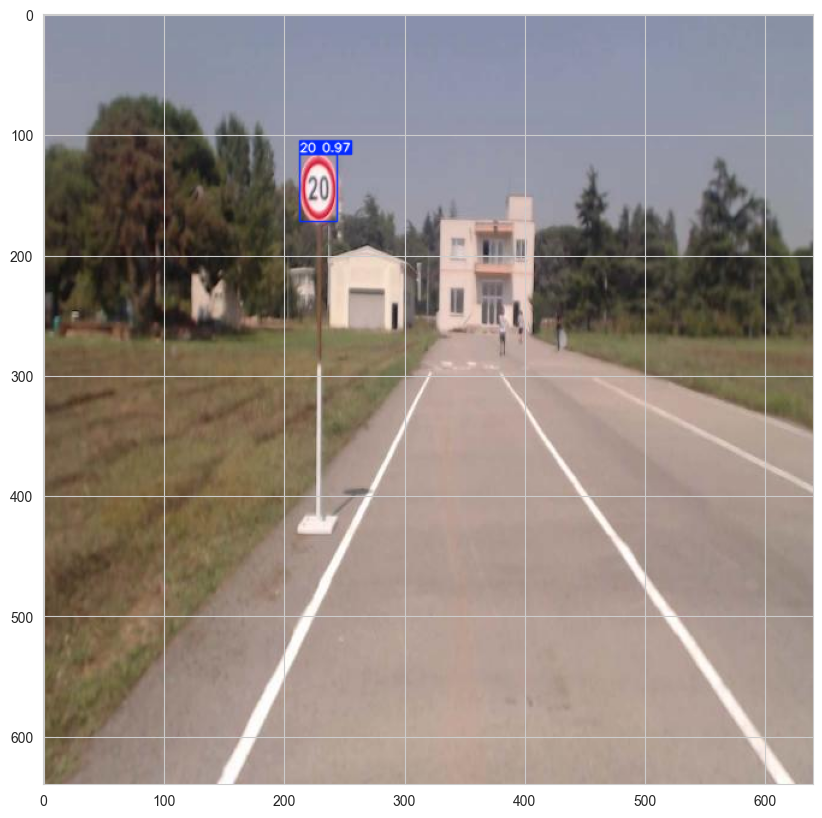

In [23]:
test_image_path='Turkey Road Sign.v1i.yolov11\\valid\\images\\20_117_jpg.rf.b1f73712bc8467798612f66a253c4bdb.jpg'
test_image = cv2.imread(test_image_path)
resized_image = resize_image(test_image)
result = test_model.predict(resized_image)
annotated = result[0].plot(line_width=1)
annotated_rgb = cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10,10))
plt.tight_layout()
plt.imshow(annotated_rgb)


0: 640x640 1 20, 42.3ms
Speed: 2.0ms preprocess, 42.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 30, 43.1ms
Speed: 2.1ms preprocess, 43.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 30, 43.4ms
Speed: 2.3ms preprocess, 43.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dur, 46.1ms
Speed: 2.7ms preprocess, 46.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 dur, 43.9ms
Speed: 2.0ms preprocess, 43.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 durak, 46.7ms
Speed: 2.6ms preprocess, 46.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 durak, 42.9ms
Speed: 2.7ms preprocess, 42.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 durak, 43.7ms
Speed: 2.6ms preprocess, 43.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1

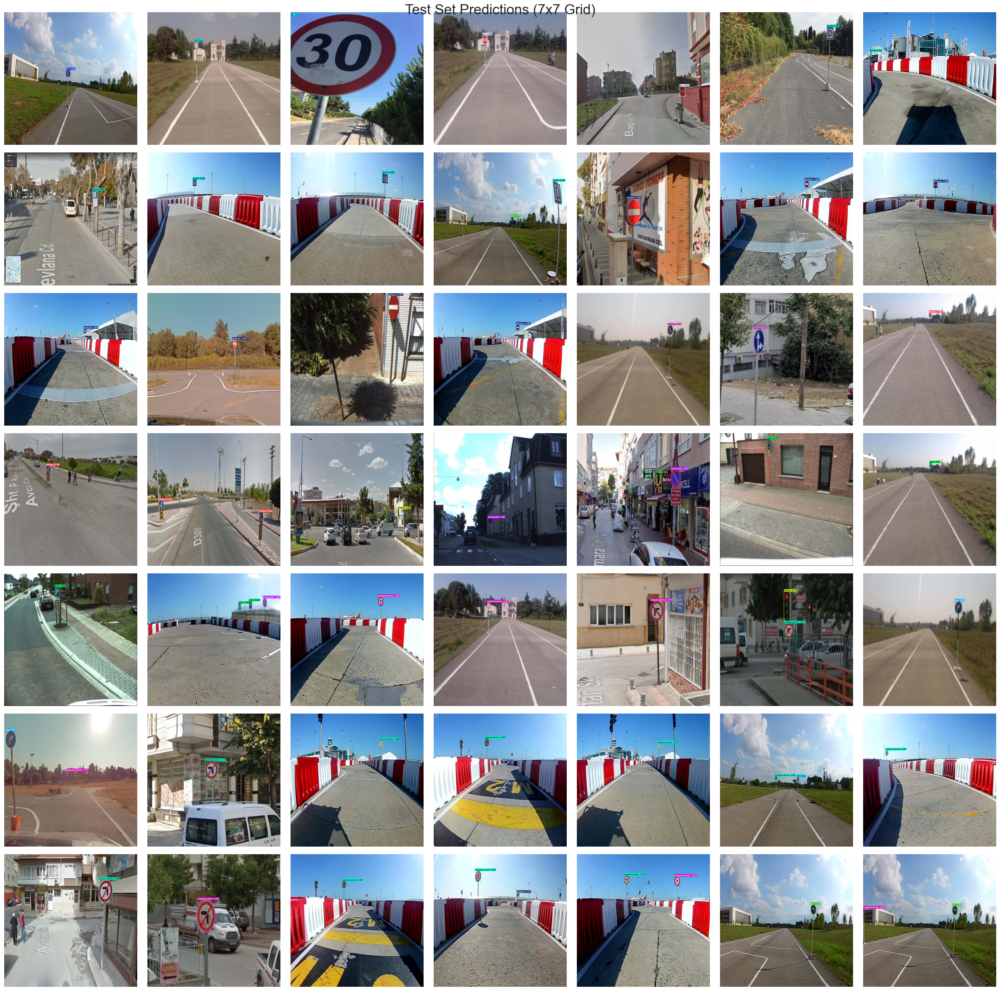

In [24]:


test_images_path = 'Turkey Road Sign.v1i.yolov11\\valid\\images'
image_files = [f for f in os.listdir(test_images_path) if f.lower().endswith('.jpg')]

step = max(1, len(image_files) // 49)
selected_images = image_files[::step][:49]

fig, axes = plt.subplots(7, 7, figsize=(24, 24))
fig.suptitle('Test Set Predictions (7x7 Grid)', fontsize=24)

for ax, img_name in zip(axes.flatten(), selected_images):
    img_path = os.path.join(test_images_path, img_name)
    img = cv2.imread(img_path)
    if img is not None:
        img_resized = resize_image(img)
        results = test_model.predict(source=img_resized, imgsz=640, conf=0.5)
        annotated = results[0].plot(line_width=1)
        annotated_rgb = cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB)
        ax.imshow(annotated_rgb)
    else:
        ax.text(0.5, 0.5, 'Load failed', ha='center', va='center')
    ax.axis('off')

plt.tight_layout()
plt.show()


# Save Model

In [25]:
# Load your trained model
best_model_path = "runs/detect/train2/weights/best.pt"
model = YOLO(best_model_path)

model.export(format="onnx")  

Ultralytics 8.3.237  Python-3.13.9 torch-2.8.0+cpu CPU (AMD Ryzen 5 5600 6-Core Processor)
YOLO11n summary (fused): 100 layers, 2,585,272 parameters, 0 gradients, 6.3 GFLOPs

PyTorch: starting from 'runs\detect\train2\weights\best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 20, 8400) (5.2 MB)

ONNX: starting export with onnx 1.19.1 opset 22...
ONNX: slimming with onnxslim 0.1.80...
ONNX: export success  1.8s, saved as 'runs\detect\train2\weights\best.onnx' (10.1 MB)

Export complete (2.1s)
Results saved to C:\Users\ozexg\OneDrive\Desktop\reda traffic\runs\detect\train2\weights
Predict:         yolo predict task=detect model=runs\detect\train2\weights\best.onnx imgsz=640  
Validate:        yolo val task=detect model=runs\detect\train2\weights\best.onnx imgsz=640 data=Turkey Road Sign.v1i.yolov11/data.yaml  
Visualize:       https://netron.app


'runs\\detect\\train2\\weights\\best.onnx'

In [3]:
import os
import time
import tkinter as tk
from tkinter import ttk, messagebox
import cv2
from PIL import Image, ImageTk
from ultralytics import YOLO


class TrafficSignDetectorApp:
    def __init__(self, root):
        self.root = root
        self.root.title("Turkey Road Sign Detector")
        self.root.geometry("1100x780")
        self.root.minsize(980, 680)

        # ---- State ----
        self.model = None
        self.cap = None
        self.is_running = False
        self.last_t = time.time()
        self.fps = 0.0

        # ---- Theme ----
        self._apply_theme()

        # ---- Layout: Root container ----
        self.container = ttk.Frame(self.root, padding=16)
        self.container.pack(fill=tk.BOTH, expand=True)

        # Header
        self._build_header()

        # Main content split: video (left) + sidebar (right)
        self.main = ttk.Frame(self.container)
        self.main.pack(fill=tk.BOTH, expand=True, pady=(14, 0))

        self.main.columnconfigure(0, weight=4)  # video
        self.main.columnconfigure(1, weight=2)  # sidebar
        self.main.rowconfigure(0, weight=1)

        self._build_video_panel()
        self._build_sidebar()

        # Footer help text
        self.footer = ttk.Label(
            self.container,
            text="Tip: Use good lighting and hold the sign steady for best results.",
            style="Muted.TLabel"
        )
        self.footer.pack(anchor="w", pady=(10, 0))

    # ---------------- UI BUILDERS ----------------

    def _apply_theme(self):
        self.root.configure(bg="#0b1020")
        style = ttk.Style()

        # Use a built-in theme as baseline
        try:
            style.theme_use("clam")
        except:
            pass

        # General
        style.configure(".", font=("Segoe UI", 11))
        style.configure("TFrame", background="#0b1020")
        style.configure("Card.TFrame", background="#121a33", relief="flat")

        style.configure("TLabel", background="#0b1020", foreground="#e7ecff")
        style.configure("Title.TLabel", font=("Segoe UI", 18, "bold"), foreground="#ffffff")
        style.configure("Subtitle.TLabel", font=("Segoe UI", 11), foreground="#b8c0ff")
        style.configure("Muted.TLabel", foreground="#9aa5d1")

        # Status pill
        style.configure("Pill.TLabel", background="#1b2550", foreground="#dbe3ff", padding=(10, 4))

        # Buttons
        style.configure("Primary.TButton", padding=(14, 10), background="#3b82f6", foreground="white")
        style.map(
            "Primary.TButton",
            background=[("active", "#2563eb"), ("disabled", "#2a355e")],
            foreground=[("disabled", "#c7cffc")]
        )

        style.configure("Secondary.TButton", padding=(14, 10), background="#22305c", foreground="#e7ecff")
        style.map(
            "Secondary.TButton",
            background=[("active", "#2b3a72"), ("disabled", "#1a2347")],
            foreground=[("disabled", "#a7b0e6")]
        )

        style.configure("Danger.TButton", padding=(14, 10), background="#ef4444", foreground="white")
        style.map(
            "Danger.TButton",
            background=[("active", "#dc2626"), ("disabled", "#3a1f2b")],
            foreground=[("disabled", "#f3c6cc")]
        )

        # Slider
        style.configure("TScale", background="#121a33")

        # Listbox container label
        style.configure("Section.TLabel", font=("Segoe UI", 11, "bold"), foreground="#ffffff", background="#121a33")

    def _build_header(self):
        header = ttk.Frame(self.container)
        header.pack(fill=tk.X)

        left = ttk.Frame(header)
        left.pack(side=tk.LEFT, fill=tk.X, expand=True)

        ttk.Label(left, text="Turkey Road Sign Detector", style="Title.TLabel").pack(anchor="w")

        right = ttk.Frame(header)
        right.pack(side=tk.RIGHT)

        self.status_var = tk.StringVar(value="Status: waiting for model…")
        self.status_pill = ttk.Label(right, textvariable=self.status_var, style="Pill.TLabel")
        self.status_pill.pack(anchor="e")

    def _build_video_panel(self):
        self.video_card = ttk.Frame(self.main, style="Card.TFrame", padding=14)
        self.video_card.grid(row=0, column=0, sticky="nsew", padx=(0, 12))

        # Metrics strip
        strip = ttk.Frame(self.video_card, style="Card.TFrame")
        strip.pack(fill=tk.X, pady=(0, 10))

        self.fps_var = tk.StringVar(value="FPS: —")
        self.det_var = tk.StringVar(value="Detections: —")

        ttk.Label(strip, textvariable=self.fps_var, style="Muted.TLabel").pack(side=tk.LEFT)
        ttk.Label(strip, textvariable=self.det_var, style="Muted.TLabel").pack(side=tk.RIGHT)

        # Video canvas area
        self.video_bg = tk.Frame(self.video_card, bg="#000000", highlightthickness=1, highlightbackground="#24305a")
        self.video_bg.pack(fill=tk.BOTH, expand=True)

        self.video_label = tk.Label(self.video_bg, bg="black")
        self.video_label.pack(fill=tk.BOTH, expand=True)

    def _build_sidebar(self):
        self.side = ttk.Frame(self.main)
        self.side.grid(row=0, column=1, sticky="nsew")
        self.side.rowconfigure(2, weight=1)  # allow list to grow

        # Controls card
        controls = ttk.Frame(self.side, style="Card.TFrame", padding=14)
        controls.grid(row=0, column=0, sticky="ew")
        controls.columnconfigure(0, weight=1)

        ttk.Label(controls, text="Controls", style="Section.TLabel").grid(row=0, column=0, sticky="w", pady=(0, 10))

        row2 = ttk.Frame(controls, style="Card.TFrame")
        row2.grid(row=2, column=0, sticky="ew")
        row2.columnconfigure(0, weight=1)
        row2.columnconfigure(1, weight=1)

        self.btn_start = ttk.Button(row2, text="Start Camera", command=self.start_detection, style="Primary.TButton", state=tk.DISABLED)
        self.btn_start.grid(row=0, column=0, sticky="ew", padx=(0, 6))

        self.btn_stop = ttk.Button(row2, text="Stop", command=self.stop_detection, style="Danger.TButton", state=tk.DISABLED)
        self.btn_stop.grid(row=0, column=1, sticky="ew", padx=(6, 0))

        # Settings card
        settings = ttk.Frame(self.side, style="Card.TFrame", padding=14)
        settings.grid(row=1, column=0, sticky="ew", pady=(12, 0))
        settings.columnconfigure(0, weight=1)

        ttk.Label(settings, text="Settings", style="Section.TLabel").grid(row=0, column=0, sticky="w", pady=(0, 10))

        self.conf_var = tk.DoubleVar(value=0.25)
        ttk.Label(settings, text="Confidence Threshold", style="Muted.TLabel").grid(row=1, column=0, sticky="w")
        self.conf_scale = ttk.Scale(settings, from_=0.05, to=0.9, variable=self.conf_var, orient="horizontal")
        self.conf_scale.grid(row=2, column=0, sticky="ew", pady=(6, 0))

        # Detections card
        det_card = ttk.Frame(self.side, style="Card.TFrame", padding=14)
        det_card.grid(row=2, column=0, sticky="nsew", pady=(12, 0))
        det_card.rowconfigure(1, weight=1)
        det_card.columnconfigure(0, weight=1)

        ttk.Label(det_card, text="Recent Detections", style="Section.TLabel").grid(row=0, column=0, sticky="w", pady=(0, 10))

        self.det_list = tk.Listbox(
            det_card,
            bg="#0e152b",
            fg="#e7ecff",
            highlightthickness=1,
            highlightbackground="#24305a",
            relief="flat",
            font=("Consolas", 10),
        )
        self.det_list.grid(row=1, column=0, sticky="nsew")

        # Small instruction line
        self.hint = ttk.Label(
            det_card,
            text="Shows top detections per frame (name, conf).",
            style="Muted.TLabel"
        )
        self.hint.grid(row=2, column=0, sticky="w", pady=(10, 0))

    # ---------------- APP LOGIC ----------------

    def start_detection(self):

        self.cap = cv2.VideoCapture(0)
        if not self.cap.isOpened():
            messagebox.showerror("Error", "Could not open video source.")
            return

        # Optional: improve camera latency (may not work on all backends)
        try:
            self.cap.set(cv2.CAP_PROP_BUFFERSIZE, 1)
        except:
            pass

        self.is_running = True
        self.btn_start.config(state=tk.DISABLED)
        self.btn_stop.config(state=tk.NORMAL)
        self._set_status("Camera running", kind="ok")

        self.last_t = time.time()
        self.process_frame()

    def stop_detection(self):
        self.is_running = False
        if self.cap:
            self.cap.release()
            self.cap = None

        self.video_label.config(image="")
        self.btn_start.config(state=tk.NORMAL if self.model else tk.DISABLED)
        self.btn_stop.config(state=tk.DISABLED)

        self.fps_var.set("FPS: —")
        self.det_var.set("Detections: —")
        self.det_list.delete(0, tk.END)
        self._set_status("Stopped", kind="info")

    def process_frame(self):
        if not (self.is_running and self.cap):
            return

        ret, frame = self.cap.read()
        if ret:
            # ---- Inference ----
            conf = float(self.conf_var.get())
            results = self.model.predict(frame, conf=conf, imgsz=640, verbose=False)

            # Draw
            annotated = results[0].plot()

            # ---- Metrics ----
            now = time.time()
            dt = now - self.last_t
            if dt > 0:
                self.fps = 0.9 * self.fps + 0.1 * (1.0 / dt) if self.fps else (1.0 / dt)
            self.last_t = now

            n = 0 if results[0].boxes is None else len(results[0].boxes)
            self.fps_var.set(f"FPS: {self.fps:.1f}")
            self.det_var.set(f"Detections: {n}")

            # ---- Update detections list (top 5) ----
            self.det_list.delete(0, tk.END)
            if n:
                names = results[0].names
                boxes = results[0].boxes
                # boxes.conf and boxes.cls are tensors
                confs = boxes.conf.cpu().numpy()
                clss = boxes.cls.cpu().numpy().astype(int)

                # sort by confidence desc
                idx = confs.argsort()[::-1][:5]
                for i in idx:
                    self.det_list.insert(tk.END, f"{names[clss[i]]:>18s}  conf={confs[i]:.2f}")

            # ---- Render frame ----
            rgb = cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB)
            img = Image.fromarray(rgb)

            # Optional: scale to fit label size (better look on resize)
            w = self.video_bg.winfo_width()
            h = self.video_bg.winfo_height()
            if w > 10 and h > 10:
                img = img.resize((w, h))

            imgtk = ImageTk.PhotoImage(image=img)
            self.video_label.imgtk = imgtk
            self.video_label.configure(image=imgtk)

        self.root.after(10, self.process_frame)

    def _set_status(self, text, kind="info"):
        self.status_var.set(f"Status: {text}")

        # Change pill color subtly by kind
        # ttk styling can't easily change per-widget background in a portable way,
        # so we adjust text only here. If you want per-state pill colors,
        # we can swap to a tk.Label pill instead of ttk.Label.
        # For now: keep consistent.

        if kind == "ok":
            pass
        elif kind == "bad":
            pass
        else:
            pass


    def _load_model_on_startup(self):
        model_path = "runs/detect/train2/weights/best.pt"
        try:
            self._set_status("Loading model…", kind="info")
            self.root.update()

            self.model = YOLO(model_path)

            self._set_status("Model loaded", kind="ok")
            self.btn_start.config(state=tk.NORMAL)
        except Exception as e:
            self._set_status("Failed to load model", kind="bad")
            messagebox.showerror("Startup Error", f"Model could not be loaded:\n{e}")



In [4]:
root = tk.Tk()
app = TrafficSignDetectorApp(root)
app._load_model_on_startup()
root.mainloop()

: 